<a href="https://colab.research.google.com/github/aryanpandey742/Data-Science-project-/blob/main/Geo_Spatial_Poverty.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [9]:
from google.colab import files
uploaded = files.upload()

Saving 2011_Dist.dbf to 2011_Dist.dbf
Saving 2011_Dist.prj to 2011_Dist.prj
Saving 2011_Dist.sbn to 2011_Dist.sbn
Saving 2011_Dist.sbx to 2011_Dist.sbx
Saving 2011_Dist.shp to 2011_Dist.shp
Saving 2011_Dist.shx to 2011_Dist.shx


In [10]:
import geopandas as gpd

# Replace with your shapefile name (without extension)
gdf = gpd.read_file("2011_Dist.shp")

# Optional: Preview
print(gdf.columns)
gdf.head()


Index(['DISTRICT', 'ST_NM', 'ST_CEN_CD', 'DT_CEN_CD', 'censuscode',
       'geometry'],
      dtype='object')


,DISTRICT,ST_NM,ST_CEN_CD,DT_CEN_CD,censuscode,geometry
0,Adilabad,Andhra Pradesh,28,1,532,"POLYGON ((78.84972 19.7601, 78.85102 19.75945,..."
1,Agra,Uttar Pradesh,9,15,146,"POLYGON ((78.19803 27.4028, 78.19804 27.40278,..."
2,Ahmadabad,Gujarat,24,7,474,"MULTIPOLYGON (((72.03456 23.50527, 72.03337 23..."
3,Ahmadnagar,Maharashtra,27,26,522,"POLYGON ((74.67333 19.9467, 74.67393 19.93509,..."
4,Aizawl,Mizoram,15,3,283,"POLYGON ((92.98749 24.40453, 92.99107 24.40236..."


In [11]:
gdf = gdf.rename(columns={"DISTRICT": "district"})  # replace as needed
gdf["district"] = gdf["district"].str.lower().str.strip()


In [43]:
uploaded = files.upload()  # Upload poverty dataset


Saving DATESET2.xlsx to DATESET2.xlsx


In [46]:
import pandas as pd

poverty = pd.read_excel("DATESET2.xlsx")
poverty["district"] = poverty["district"].str.lower().str.strip()
poverty.head()

,State,district,poverty,Area (sq km),Households,Total Population,Total Males,Total Females,Literate Population,Literate Males,...,Muslims,Sikhs,Buddhists,Jains,Others_Religions,Religion_Not_Stated,Households.1,Rural_Households,Urban_Households,Households_with_Internet
0,ANDAMAN AND NICOBAR ISLANDS,nicobars,5.28,16105,649849,2741239,1369597,1371642,1483347,856350,...,275970,1377,25510,617,322,22120,817714,597466,220248,5512
1,ANDAMAN AND NICOBAR ISLANDS,north & middle andaman,9.32,4041,710566,4418797,2364953,2053844,2680510,1614594,...,411313,12057,4049,21508,384,36692,903823,496971,406852,27183
2,ANDAMAN AND NICOBAR ISLANDS,south andaman,2.20,8107,1510134,7214225,3788051,3426174,5435760,3025463,...,883238,14542,4518,209287,2055,7415,2198552,353169,1845383,126341
3,ANDHRA PRADESH,adilabad,27.12,17048,930024,4543159,2342825,2200334,3151890,1773355,...,320743,5431,33898,38718,1408,13052,1323404,1041393,282011,18370
4,ANDHRA PRADESH,anantapur,12.47,3576,82524,400309,199270,201039,340595,169547,...,5264,105,1570,76,505,406,100911,20570,80341,4019


In [114]:
merged = gdf.merge(poverty, on="district", how="left")
print(f"Matched districts with data: {merged['poverty'].notnull().sum()}")


# Drop rows where geometry is missing or invalid
cleaned = merged[merged.geometry.notnull() & merged.geometry.is_valid & ~merged.geometry.is_empty]
cleaned = cleaned.dropna(subset=["poverty"])


Matched districts with data: 628


In [115]:
# Clean up strings safely
poverty["poverty"] = (
    poverty["poverty"]
    .astype(str)              # Ensure string type
    .str.extract(r'([\d\.]+)')  # Extract numeric part
    .astype(float)
)

In [116]:
print("Valid geometries:", merged.geometry.is_valid.sum())
print("Empty geometries:", merged.geometry.is_empty.sum())
print("Total geometries:", len(merged))


Valid geometries: 656
Empty geometries: 0
Total geometries: 657


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


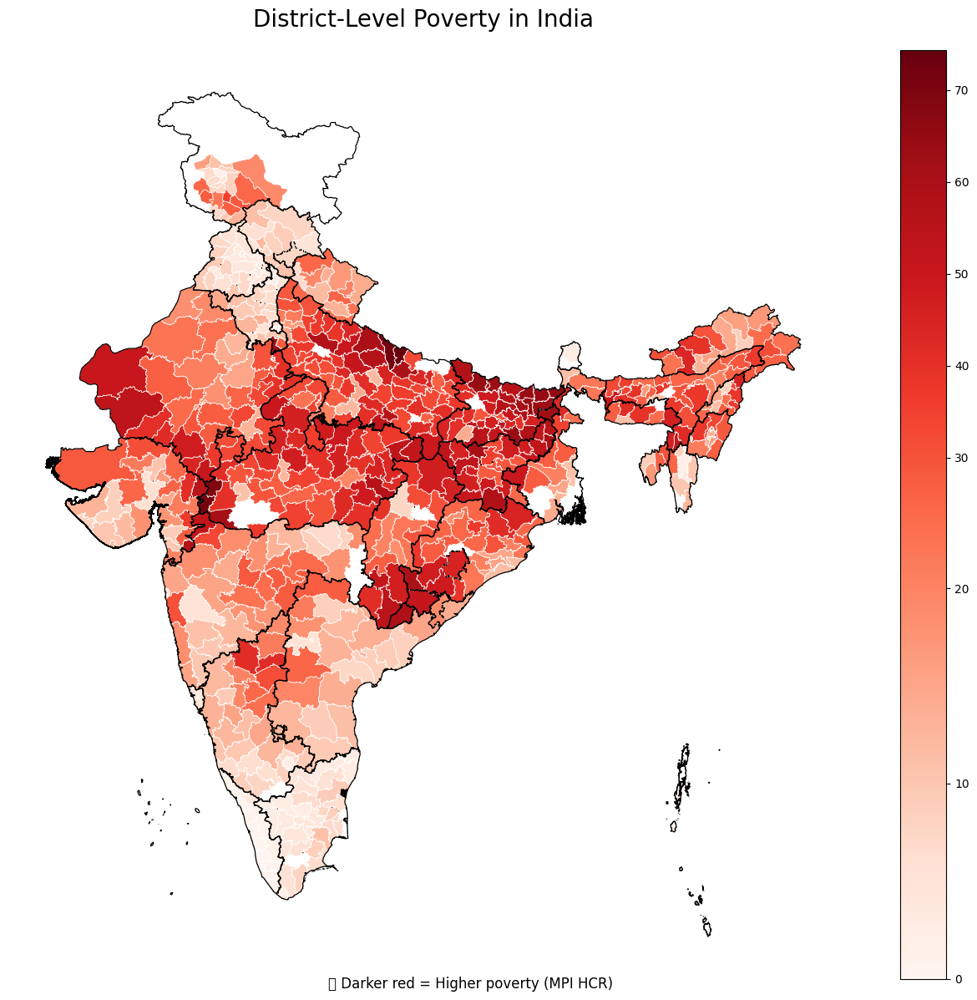

In [117]:
# STEP 5: Setup color scale
from matplotlib.colors import TwoSlopeNorm
vmin = merged["poverty"].min()
vmax = merged["poverty"].max()
vcenter = merged["poverty"].median()

if vmin == vmax:
    vmax = vmin + 0.01
if not (vmin < vcenter < vmax):
    vcenter = (vmin + vmax) / 2

# STEP 6: Plot
fig, ax = plt.subplots(1, 1, figsize=(15, 12))

merged.plot(
    column="poverty",
    cmap="Reds",
    linewidth=0.5,
    edgecolor="white",
    legend=True,
    norm=TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax),
    ax=ax
)


state_gdf = merged.dissolve(by="ST_NM")  # if you have state names in merged
state_gdf.boundary.plot(ax=ax, linewidth=0.9, color="Black")

# Add titles
ax.set_title("District-Level Poverty in India", fontsize=20, pad=20)
plt.figtext(
    0.5, 0.01,
    "🔴 Darker red = Higher poverty (MPI HCR)",
    ha="center",
    fontsize=12,
    color="black"
)

ax.axis("off")
plt.tight_layout()
plt.show()

In [118]:
import folium
import branca.colormap as cm
import geopandas as gpd

# Filter out invalid geometries or missing poverty data
merged = merged[merged['poverty'].notnull() & merged['geometry'].notnull()]

# Convert GeoDataFrame to GeoJSON
geojson_data = merged.to_json()

# Create color map (adjust min and max if needed)
min_poverty = merged['poverty'].min()
max_poverty = merged['poverty'].max()


# Initialize folium map centered on India
m = folium.Map(location=[22.5, 80], zoom_start=5, tiles="CartoDB positron")

# Add choropleth layer
folium.Choropleth(
    geo_data=geojson_data,
    name="Poverty Rate",
    data=merged,
    columns=["district", "poverty"],
    key_on="feature.properties.district",
    fill_color="YlOrRd",
    fill_opacity=0.8,
    line_opacity=0.4,
    legend_name="Poverty Rate (%)",
    highlight=True,
).add_to(m)

# Add district labels for top 10 poorest
top_districts = merged.sort_values(by="poverty", ascending=False).head(20)
for _, row in top_districts.iterrows():
    if row['geometry'].centroid.is_empty:
        continue
    lon, lat = row['geometry'].centroid.coords[0]
    folium.Marker(
        location=[lat, lon],
        popup=f"{row['district']}: {row['poverty']}%",
        icon=folium.Icon(color="red", icon="info-sign")
    ).add_to(m)






# Display the map
m

In [119]:
!pip install geopandas libpysal esda mapclassify matplotlib
import geopandas as gpd
import libpysal
from esda import Moran, Moran_Local
import matplotlib.pyplot as plt
import seaborn as sns


<ipython-input-120-4293838200>:10: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = Queen.from_dataframe(merged)
/usr/local/lib/python3.11/dist-packages/libpysal/weights/contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 5 disconnected components.
 There are 4 islands with ids: 276, 411, 626, 627.
  W.__init__(self, neighbors, ids=ids, **kw)


('WARNING: ', 276, ' is an island (no neighbors)')
('WARNING: ', 411, ' is an island (no neighbors)')
('WARNING: ', 626, ' is an island (no neighbors)')
('WARNING: ', 627, ' is an island (no neighbors)')


/usr/local/lib/python3.11/dist-packages/esda/moran.py:1350: RuntimeWarning: invalid value encountered in divide
  self.z_sim = (self.Is - self.EI_sim) / self.seI_sim


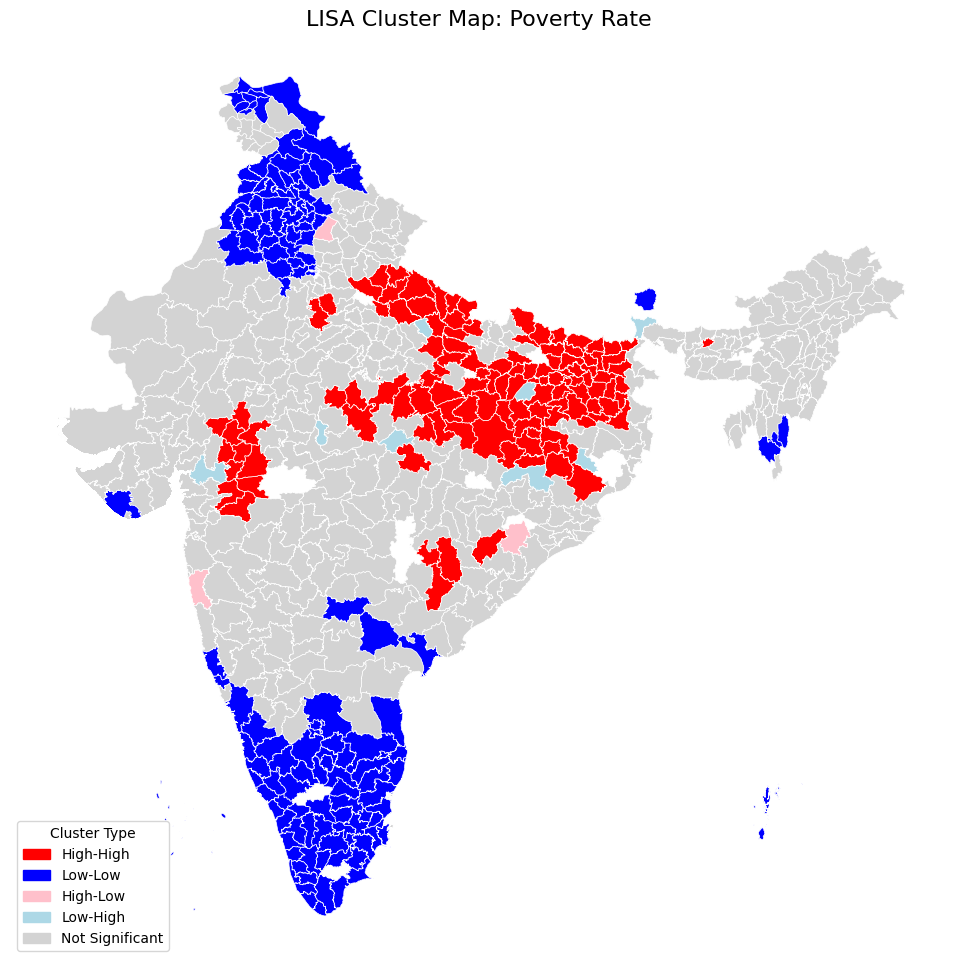

In [120]:
import geopandas as gpd
import matplotlib.pyplot as plt
import mapclassify
from libpysal.weights import Queen
from esda import Moran_Local
import matplotlib.patches as mpatches
from libpysal.weights import Queen

# STEP 1: Calculate spatial weights
w = Queen.from_dataframe(merged)
w.transform = 'r'

# STEP 2: Calculate LISA
lisa = Moran_Local(merged['poverty'], w)

# STEP 3: Create LISA cluster categories
merged['lisa_cluster'] = lisa.q
merged['significant'] = lisa.p_sim < 0.05

# STEP 4: Create cluster colors only for significant values
def cluster_label(row):
    if not row['significant']:
        return 'Not Significant'
    elif row['lisa_cluster'] == 1:
        return 'High-High'
    elif row['lisa_cluster'] == 2:
        return 'Low-High'
    elif row['lisa_cluster'] == 3:
        return 'Low-Low'
    elif row['lisa_cluster'] == 4:
        return 'High-Low'

merged['lisa_category'] = merged.apply(cluster_label, axis=1)

# STEP 5: Define color mapping
colors = {
    'High-High': 'red',
    'Low-Low': 'blue',
    'High-Low': 'pink',
    'Low-High': 'lightblue',
    'Not Significant': 'lightgrey'
}
merged['color'] = merged['lisa_category'].map(colors)

# STEP 6: Plot the LISA map
fig, ax = plt.subplots(1, figsize=(14, 12))
merged.plot(color=merged['color'], edgecolor='white', linewidth=0.5, ax=ax)

ax.set_title('LISA Cluster Map: Poverty Rate', fontsize=16)
ax.axis('off')

# STEP 7: Add custom legend
legend_patches = [mpatches.Patch(color=color, label=label) for label, color in colors.items()]
ax.legend(handles=legend_patches, loc='lower left', title='Cluster Type')

plt.show()


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 389.9/389.9 kB 4.5 MB/s eta 0:00:00


In [121]:
import geopandas as gpd
import pandas as pd
from libpysal.weights import Queen
from spreg import ML_Lag, ML_Error
from sklearn.preprocessing import StandardScaler

# Drop rows with missing data
data = merged.dropna(subset=["poverty", "Total Working Population", "SC", "ST"])


# Select dependent and independent variables
y = data["poverty"].values.reshape(-1, 1)
X = data[[
    "Total Working Population",
    "SC",  # Scheduled Caste
    "ST",  # Scheduled Tribe

]].values

# Standardize variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


In [122]:
from libpysal.weights import Queen

# Queen contiguity weights based on geometry
w = Queen.from_dataframe(data)
w.transform = 'r'


<ipython-input-122-676486881>:4: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = Queen.from_dataframe(data)


('WARNING: ', 276, ' is an island (no neighbors)')
('WARNING: ', 411, ' is an island (no neighbors)')
('WARNING: ', 626, ' is an island (no neighbors)')
('WARNING: ', 627, ' is an island (no neighbors)')


/usr/local/lib/python3.11/dist-packages/libpysal/weights/contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 5 disconnected components.
 There are 4 islands with ids: 276, 411, 626, 627.
  W.__init__(self, neighbors, ids=ids, **kw)


In [123]:
from spreg import ML_Lag

slm = ML_Lag(y, X_scaled, w=w, name_y='poverty', name_x=["Total Working Population","SC", "ST"])
print(slm.summary)


REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG (METHOD = FULL)
-----------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :     poverty                Number of Observations:         628
Mean dependent var  :     25.3804                Number of Variables   :           5
S.D. dependent var  :     17.1187                Degrees of Freedom    :         623
Pseudo R-squared    :      0.7071
Spatial Pseudo R-squared:  0.0155
Log likelihood      :  -2371.8492
Sigma-square ML     :     91.1124                Akaike info criterion :    4753.698
S.E of regression   :      9.5453                Schwarz criterion     :    4775.911

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------------------------------------------------------

In [124]:
from spreg import ML_Error

sem = ML_Error(y, X_scaled, w=w, name_y='poverty', name_x=["Total Working Population","SC", "ST"])
print(sem.summary)


/usr/local/lib/python3.11/dist-packages/spreg/ml_error.py:184: RuntimeWarning: Method 'bounded' does not support relative tolerance in x; defaulting to absolute tolerance.
  res = minimize_scalar(


REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ML SPATIAL ERROR (METHOD = full)
---------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :     poverty                Number of Observations:         628
Mean dependent var  :     25.3804                Number of Variables   :           4
S.D. dependent var  :     17.1187                Degrees of Freedom    :         624
Pseudo R-squared    :      0.0058
Log likelihood      :  -2373.4773
Sigma-square ML     :     90.9830                Akaike info criterion :    4754.955
S.E of regression   :      9.5385                Schwarz criterion     :    4772.725

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT        22.26634    

In [125]:
#Multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor
merged = merged.replace([np.inf, -np.inf], np.nan)  # Replace inf with NaN
merged = merged.dropna(subset=["Total Working Population", "SC", "ST"])  # Drop rows with NaNs

X = merged[["Total Working Population", "SC", "ST"]]
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif_data)


                    feature       VIF
0  Total Working Population  7.149238
1                        SC  5.722958
2                        ST  1.645361


In [126]:
#Skewness
merged[['Total Working Population', 'SC', 'ST']].skew()


,0
Total Working Population,1.969354
SC,2.113360
ST,2.733763
